# Валидация модели и подбор точки отсечения

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import torch

from sklearn.metrics import roc_curve, auc
import matplotlib.patches as patches

import os
import os.path as os_path
from sys import path

cpfn = "diplom_project"

curr_dir = os.getcwd()
curr_dir = os_path.join(curr_dir[:curr_dir.find(cpfn)], cpfn)

# пути исходных данных
data_storage = os_path.join(curr_dir, "data_storage")
inc_los_dir = os_path.join(data_storage, 'inc_los_data')
fit_and_valid_fold = os_path.join(data_storage, "fiting_and_valid")

# код и обученные модели
prog_fold = os_path.join(curr_dir, "prog")
models_fold = os_path.join(prog_fold, "model")
one_lay_113_neu_mod_dir = os_path.join(models_fold, 'model 1lay 113 neurons')

# путь к этому notebook и результатам выполенния
def_works_fold = os_path.join(prog_fold, "defence_works")
results_fold = os_path.join(def_works_fold, "model_valid")
pbars_table_dir = os_path.join(results_fold, 'phat_tables')

phat_econ_prof_dir = os_path.join(fit_and_valid_fold, 'phat_econ_prof')

if models_fold not in path:
    path.append(models_fold)
    
# это обязательно нужно для того
# чтобы считать предобученную модель
from nets_algo import *

# Загрузка выборки и обученной модели

In [2]:
# Изначальные данные к сожалениею приходиться хранить сразу
# в трех вариантах pandas, numpy и torch
names = ["X_test", "Y_test", "X_train", "Y_train"]
# изначально массивы выгоднее всего загрузить в виде
# pandas.DataFrame так они сохранят свои индексы
pand_dfs = { 
    name : pd.read_csv(
        os_path.join(fit_and_valid_fold, name + '.csv'), index_col = 0) 
    for name in names}

pand_dfs["X_full"] = pd.concat([pand_dfs['X_train'], pand_dfs['X_test']])
pand_dfs["Y_full"] = pd.concat([pand_dfs['Y_train'], pand_dfs['Y_test']])

np_arrs = {df: np.array(pand_dfs[df])  for df in pand_dfs}

tens_arrs = {npy: torch.tensor(np_arrs[npy].astype('float32')) for npy in np_arrs}

# загрузка предобученной модели
model = ResultNet([113, 113])
model.load_state_dict(torch.load(one_lay_113_neu_mod_dir))

# Это данные о выйгрышах/потерях с каждого клиента
prof_los_data = pd.read_csv(inc_los_dir + ".csv", index_col = 0)

# Получение ROC кривой и показателя AUC производиться на тестовых данных

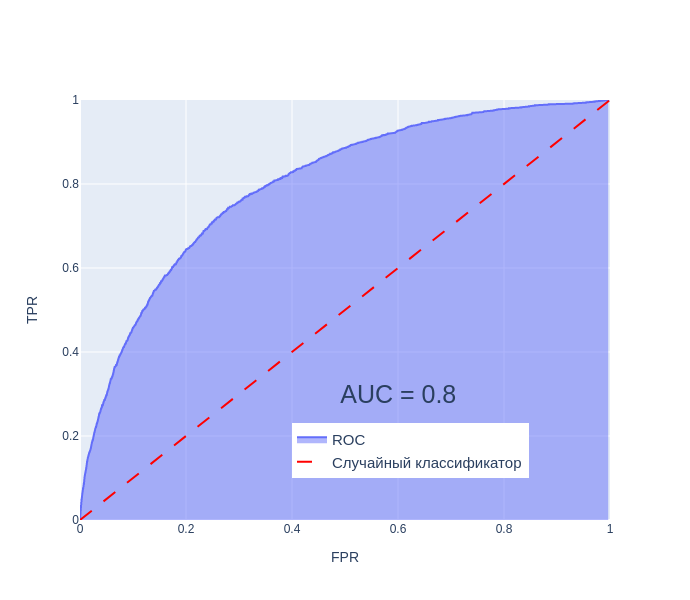

In [3]:
p_hat = model(tens_arrs['X_test']).detach().numpy()
fpr, tpr, threholds = [arr[1:-1] for arr in 
                       roc_curve(np_arrs['Y_test'], p_hat)]

fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x = fpr, y = tpr, name = "ROC", 
        # fill = 'tozeroy', 
    )
)

fig.add_trace(go.Scatter(
    x = [0, 1], y = [0, 1],
    line = dict(color = 'red', dash = 'longdash'),
    name = "Случайный классификатор",
    mode = 'lines'
))

fig.update_layout(
    height= 600,
    width = 600,
    legend = dict(
        y = 0.1,
        x = 0.4,
        font_size = 15,
    ),
    yaxis_range = [0, 1],
    xaxis_title = 'FPR',
    yaxis_title = 'TPR'
)

fig.write_image(os_path.join(results_fold, "ROC.png"))

fig.update_traces(selector = lambda trace: trace.name == "ROC", 
                  fill = 'tozeroy')
fig.add_annotation(text="AUC = 0.8",
                  x=0.6, y=0.3, showarrow=False,
                  font_size = 25)

fig.write_image(os_path.join(results_fold, "ROC_filled.png"))
fig.show()

# Подбор точки отсечения и расчёт ошибок первого/второго рода проводиться по полным данным

In [4]:
p_hat = model(tens_arrs['X_full']).detach().numpy()
fpr, tpr, threholds = [arr[1:-1] for arr in 
                       roc_curve(np_arrs['Y_full'], p_hat)]

threholds = np.sort(threholds)

# последняя предсказанная вероятность которую мы анализируем
max_p = 0.35
# условие выбора по предсказаниям вероятности
sel_cond_P = p_hat[:, 0] < max_p
# условие выбора по отсечениям в ROC
sel_cond_T = threholds < max_p

# создадим pandas.DataFrame в котором будем хранить еще и
# информацию об предсказанных вероятностях рядом с дейсвительным классом
Y_real_preds = pand_dfs['Y_full'].copy()
Y_real_preds['p_hat'] = p_hat
# туда-же экномические выйгрыши
Y_real_preds = Y_real_preds.join(prof_los_data['Выйгрыш_потеря'])

del p_hat

Базовные настройки и функции

In [5]:
# настройки стрелочек для точек отсечения
pbar_arrow_settings = dict(
    xref="x2", yref="y2",
    axref = "x2", ayref='y2',
    arrowhead = 2,
    arrowwidth = 1,
    row = 2, col = 1,
    text = "",
)

def add_projection(fig, pos, proj_axis = 'x', line = {}, ann_settings = {}):
    '''Добавление проекции на ось x с подписью'''
    # inputs:
    # fig - plotly.figure на который требуется добавить проекцию
    # pos - точка от которой должна падать процектия (x, y)
    # line - настроки падающей линии
    # proj_axis - ось на которую будет отброшена проекция 'x' или 'y'
    
    
    x, y = ([pos[0], pos[0]], [0, pos[1]]) \
        if proj_axis == 'x' \
        else ([0, pos[0]], [pos[1], pos[1]])
    
    # линия
    fig.add_trace(go.Scatter(
            x = x,
            y = y,
            line = line,
            mode = 'lines', showlegend = False
        ),
        row = 2, col = 1,
    )
    # подпись
    fig.add_annotation(
        x = x[0],
        y = y[0],
        text = str(np.round(x[0] if proj_axis == 'x' else y[0], 3)),
        row = 2, col = 1,
        **ann_settings
    )
    
def cross_tab_set_names(cross_table):
    '''Переименование колонок/индексов в табличке сопряженности pandas'''
    cross_table.index.name = "Предсказанынй класс"
    cross_table.columns.name = "Дейсвительный класс"
    
    return cross_table

## Базовый график без точек отсечения

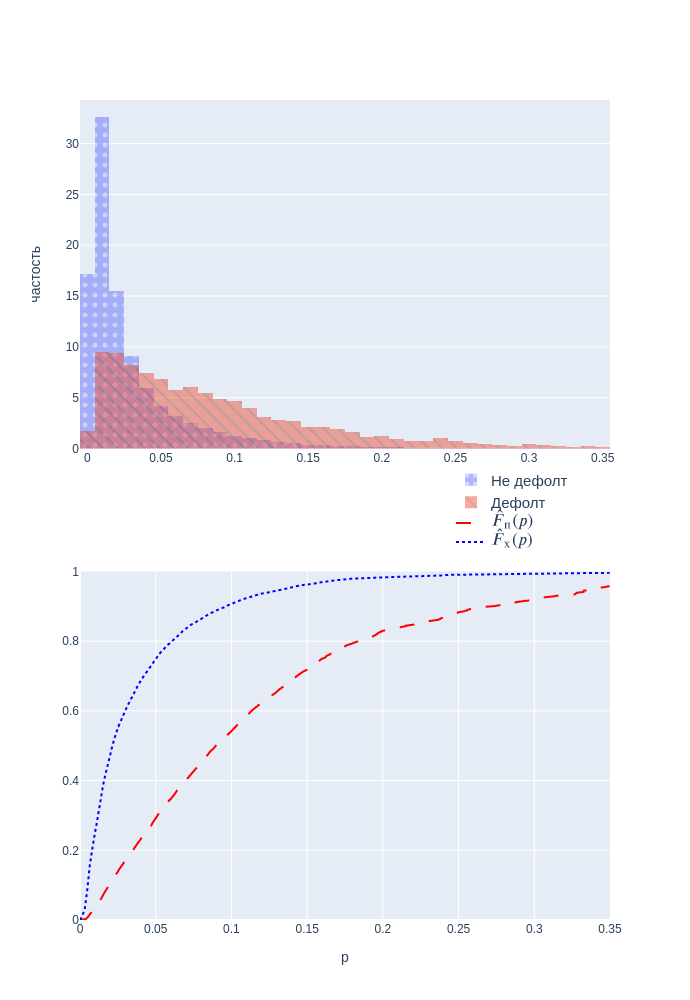

In [6]:
# fig = go.Figure()
fig = make_subplots(rows = 2, cols = 1)

# return clients p_hat
rc_p_hat = Y_real_preds.loc[
    np.logical_and(sel_cond_P, ~np_arrs['Y_full'][:,0].astype('bool')),'p_hat']
# defaults clients p_hat
dc_p_hat = Y_real_preds.loc[
    np.logical_and(sel_cond_P, np_arrs['Y_full'][:,0].astype('bool')), 'p_hat']

# гистрограмма плотности распределения
# ======================================================
hists_settings = dict(
    opacity = 0.5, nbinsx = 50, histnorm = 'percent')

fig.add_trace(
    go.Histogram(
        x = rc_p_hat,
        name = "Не дефолт",
        marker_pattern_shape = '.',
        **hists_settings),
    row = 1, col = 1
)
fig.add_trace(
    go.Histogram(
        x = dc_p_hat,
        name = "Дефолт",
        marker_pattern_shape = '\\',
        **hists_settings),
    row = 1, col = 1
)
# ======================================================

# кумулятивный процент
# ======================================================
fig.add_trace(
    go.Scatter(
        x = threholds[sel_cond_T], 
        y = fpr[sel_cond_T],
        name = 'r$\hat{F}_п(p)$',
        line = dict(color = 'red', dash = 'longdash')
    ),
    row = 2, col = 1
)

fig.add_trace(
    go.Scatter(
        x = threholds[sel_cond_T], 
        y = tpr[sel_cond_T],
        name = 'r$\hat{F}_х(p)$',
        line = dict(color = 'blue', dash = 'dot')
    ),
    row = 2, col = 1
)
# ======================================================

fig.update_layout(
    barmode = 'overlay',
    height=1000,
    width = 800,
    legend = dict(
        y = 0.5,
        x = 0.7,
        font_size = 15,
        bgcolor = 'rgba(0,0,0,0)'
    ),
    yaxis_title = 'частость',
    yaxis2_range = [0, 1],
    xaxis2_range = [0, max_p],
    xaxis2_title = 'p',
)

fig.write_image(os_path.join(results_fold, "distrs.png"))
fig.show()

## Точки отсечения, физическое и экономическое качество классификатора

### Базовный вариант точки отсчения

Как точка в которой достигается минимальная разница между долей правильно классфицированных дефолтников и ошибочных дефолтников

Сначала соответсвующая доработка в график

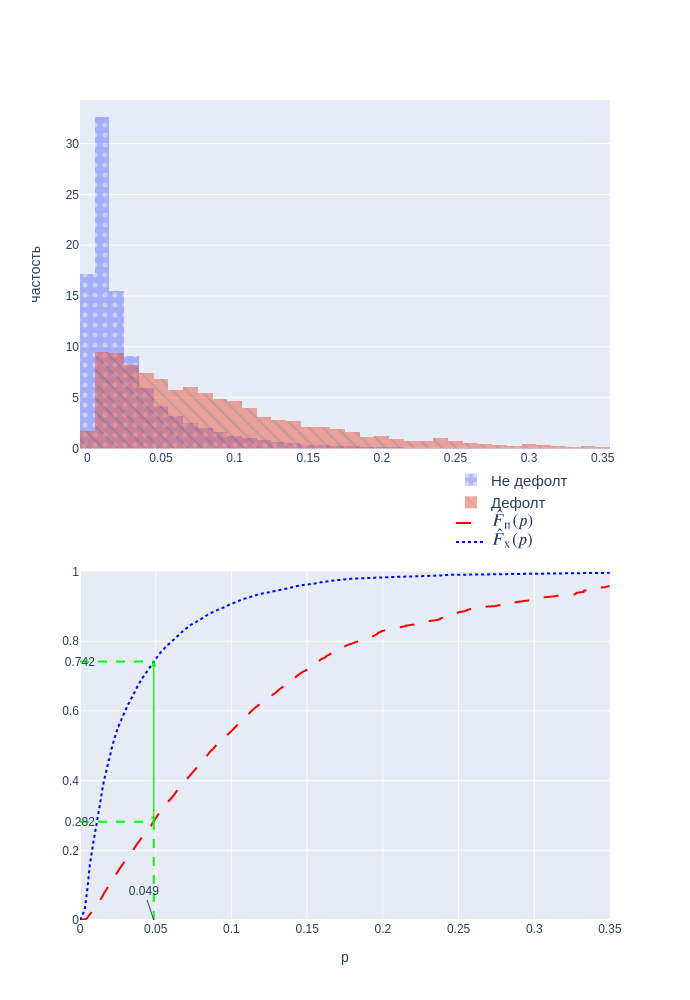

In [7]:
from copy import deepcopy
p_bar_fig = deepcopy(fig)

basic_p_bar_index = np.argmax(tpr - fpr)
p_bar_basic = threholds[basic_p_bar_index]

basic_p_bar_arrow = pbar_arrow_settings | \
                    dict(arrowcolor = 'rgb(0, 255, 0)')

p_bar_fig.add_annotation(
    **basic_p_bar_arrow,
    x = p_bar_basic, y = fpr[basic_p_bar_index],
    ax = p_bar_basic, ay = tpr[basic_p_bar_index]
)
p_bar_fig.add_annotation(
    **basic_p_bar_arrow,
    x = p_bar_basic, y = tpr[basic_p_bar_index],
    ax = p_bar_basic, ay = fpr[basic_p_bar_index]
)

prog_line_setting = dict(dash = 'dash', color = 'rgb(0, 255, 0)')
y_prog_line_arg = dict(proj_axis = 'y', ann_settings = dict(showarrow = False))

add_projection(
    p_bar_fig, (p_bar_basic, fpr[basic_p_bar_index]), 
    line = prog_line_setting
)

add_projection(
    p_bar_fig, (p_bar_basic, fpr[basic_p_bar_index]),
    line = prog_line_setting,
    **y_prog_line_arg
)
add_projection(
    p_bar_fig,(p_bar_basic, tpr[basic_p_bar_index]),
    line = prog_line_setting,
    **y_prog_line_arg
)

p_bar_fig.write_image(os_path.join(results_fold, "distrs_basic_pbar.png"))
p_bar_fig.show()

Абсолютные показатели модели при такой точке отсечения

In [8]:
Y_real_preds['y_hat'] = \
    (Y_real_preds['p_hat'] > p_bar_basic).replace({False:"Не дефолт", True: "Дефолт"})
Y_real_preds['Y_nat_names'] = \
    Y_real_preds['Y'].replace({0:"Не дефолт", 1: "Дефолт"}) 

pred_cross_tab = pd.crosstab(Y_real_preds['y_hat'], Y_real_preds['Y_nat_names'])

cross_tab_set_names(pred_cross_tab)

pred_cross_tab.to_excel(os_path.join(results_fold, 'basic_pbar_absol.xlsx'))
pred_cross_tab

Дейсвительный класс,Дефолт,Не дефолт
Предсказанынй класс,,
Дефолт,4304,37925
Не дефолт,2659,171476


Относительные показатели модели при такой точке отсечения

In [9]:
rel_pred_cols_tab =\
    (pred_cross_tab.divide(pred_cross_tab.sum(), axis = 1)*100).round(decimals = 2)
rel_pred_cols_tab.to_excel(os_path.join(results_fold, 'basic_pbar_relative.xlsx'))
rel_pred_cols_tab

Дейсвительный класс,Дефолт,Не дефолт
Предсказанынй класс,,
Дефолт,61.81,18.11
Не дефолт,38.19,81.89


Рассчитаем экономические выгоды/потери при таком выборе точки отсечения

In [10]:
econ_profits_cross_tab = cross_tab_set_names(
    Y_real_preds.groupby(
        ["y_hat", "Y_nat_names"]
    )['Выйгрыш_потеря'].sum().unstack(level=1)
).round(2)

econ_profits_cross_tab.to_excel(os_path.join(results_fold, 'basic_pbar_econ.xlsx'))
econ_profits_cross_tab

Дейсвительный класс,Дефолт,Не дефолт
Предсказанынй класс,,
Дефолт,-697447.93,5294380.56
Не дефолт,-447152.75,15328994.75


При таком варианте точки отсечения, как видно, модель теряет больше чем приносит пользы: (Дефолт; Дефолт) экономит меньше чем мы теряем на (Дефолт; Не дефолт). Исправлению этого нюанса посвящена следующий раздел.

### Точка отсчения опираясь на экономический смысл

Подберем такую точку отсечения, чтобы ошибки певого и второго рода ((Дефолт; Не дефолт) и (Не дефолт; Дефолт) соотсветсвенно) были минимальны.

Следующая ячейка позволяет для всех предсказанных вероятностей оценить потери от отказов хорошим клиентам и выдачи кредита плохим. Процедура достаточно долгая, потому сохраним результаты в отдельный файл.

Теперь ищем такую точку в которой минимальная сумма потерь

In [11]:
p_errors = pd.read_csv(phat_econ_prof_dir + '.csv', index_col = 0)

min_ind = (p_errors['first_type_err'] + p_errors['second_type_err'].abs()).idxmin()
econ_pbar = p_errors.loc[min_ind, 'p']
p_errors.loc[min_ind, :]

p                  3.388948e-01
first_type_err     6.211943e+03
second_type_err   -1.129349e+06
Name: 114933, dtype: float64

Визуализация найденной точки отсечения

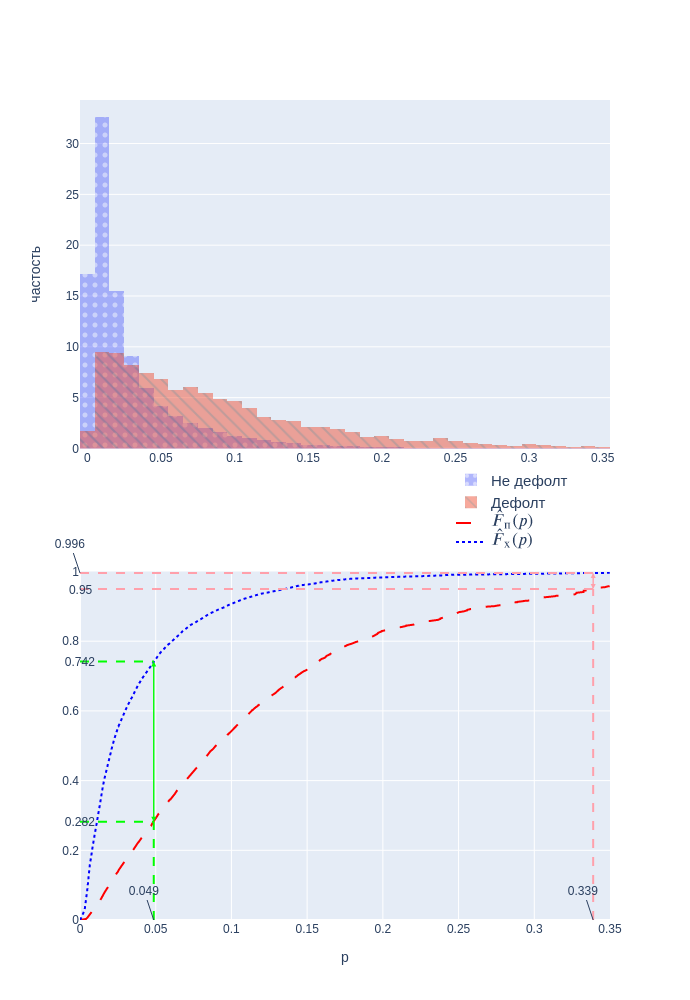

In [12]:
p_bar_econ_fig = deepcopy(p_bar_fig)


econ_pbar
# найдем индекс ближайшего отечения в ROC
threh_ind = np.argmin(np.abs(threholds - econ_pbar))

econ_p_bar_arrow = pbar_arrow_settings | \
                    dict(arrowcolor = '#FFA0AB')

p_bar_econ_fig.add_annotation(
    **econ_p_bar_arrow,
    x = econ_pbar, y = fpr[threh_ind],
    ax = econ_pbar, ay = tpr[threh_ind]
)
p_bar_econ_fig.add_annotation(
    **econ_p_bar_arrow,
    x = econ_pbar, y = tpr[threh_ind],
    ax = econ_pbar, ay = fpr[threh_ind]
)


prog_line_setting['color'] = '#FFA0AB'

add_projection(
    p_bar_econ_fig, (econ_pbar, fpr[threh_ind]), 
    line = prog_line_setting
)

add_projection(
    p_bar_econ_fig, (econ_pbar, fpr[threh_ind]),
    line = prog_line_setting,
    **y_prog_line_arg
)
add_projection(
    p_bar_econ_fig,(econ_pbar, tpr[threh_ind]),
    line = prog_line_setting,
    proj_axis = 'y'
)


p_bar_econ_fig.write_image(os_path.join(results_fold, "distrs_econ_pbar.png"))
p_bar_econ_fig.show()

# В завершении представим несколько промежуточных вариантов точки отсечения в табличной форме

In [13]:
# будем рассматривать только записи в пределах выбранных точек отсечения
res_tab = p_errors.query(
    '(p >= ' + str(p_bar_basic) + ') & (p <= ' + str(econ_pbar) + ')').copy()
# заберем только 4 промежуточных точки


res_tab = res_tab.loc[
    [((p_bar_basic + (econ_pbar - p_bar_basic)/5 * i) - res_tab['p']).abs().idxmin()\
    for i in range(5)] + [res_tab.index[0]],:
]


# res_tab.set_index('p', inplace = True)

res_tab.rename(columns = {
    'first_type_err' : 'Потери на процентах',
    'second_type_err' : 'Потери от невозврата'
}, inplace = True)


res_tab['Полученные проценты'] = \
    Y_real_preds.query('(Y_nat_names == "Не дефолт")')['Выйгрыш_потеря'].sum() -\
        res_tab['Потери на процентах']

res_tab['Предотвращенный невозврат'] = \
    Y_real_preds.query('(Y_nat_names == "Дефолт")')['Выйгрыш_потеря'].sum() -\
        res_tab['Потери от невозврата']

res_tab['Выйгрыш классификатора'] = \
    res_tab['Предотвращенный невозврат'] - res_tab['Потери на процентах']

res_tab['Правильно классифицировано дефолтов'] = res_tab['p'].apply(
    lambda p: ((Y_real_preds['p_hat'] > p) & (Y_real_preds['Y'] == 1)).sum())

res_tab['Правильно классифицировано не дефолтов'] = res_tab['p'].apply(
    lambda p: ((Y_real_preds['p_hat'] <= p) & (Y_real_preds['Y'] == 0)).sum())

res_tab['Доля правильно классифицированных дефолтов%'] = \
    res_tab['Правильно классифицировано дефолтов']*100 / \
    (Y_real_preds['Y'] == 1).sum()

res_tab['Доля правильно классифицированных не дефолтов%'] = \
    res_tab['Правильно классифицировано не дефолтов']*100 / \
    (Y_real_preds['Y'] == 0).sum()

res_tab = res_tab.round(2).abs().set_index('p')
res_tab.to_csv(pbars_table_dir + ".csv")

res_tab

,Потери на процентах,Потери от невозврата,Полученные проценты,Предотвращенный невозврат,Выйгрыш классификатора,Правильно классифицировано дефолтов,Правильно классифицировано не дефолтов,Доля правильно классифицированных дефолтов%,Доля правильно классифицированных не дефолтов%
p,,,,,,,,,
0.05,5294380.56,447152.75,15328994.75,697447.93,5991828.48,4304,171477,61.81,81.89
0.11,1339533.05,857556.12,19283842.26,287044.55,1626577.60,2132,199168,30.62,95.11
0.16,350132.66,1023652.15,20273242.65,120948.52,471081.18,1028,206352,14.76,98.54
0.22,101219.86,1088162.24,20522155.45,56438.44,157658.29,515,208329,7.40,99.49
0.28,26105.66,1117316.73,20597269.65,27283.94,53389.60,256,208990,3.68,99.80
0.34,6211.94,1129349.14,20617163.36,15251.53,21463.48,133,209235,1.91,99.92
